In [1]:
# Import libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display
from matplotlib import rc
# Set animation back-end
rc('animation', html='jshtml') # or html5 

# Use seaborn to make the plots look nicer
import seaborn as sns
sns.set_context('notebook', font_scale=1.5)

In [2]:
# Parameters of the simulation
L = 1 # width of the square well
h_bar = 1 # for ease of calculations
m_2 = 1 # this is 2*m

omega_i = np.pi**2 # frequency of ground state
omega_f = (2**2)*(np.pi**2)  # frequency of 1st excited state

In [3]:
# x-values for the square well
x = np.linspace(-L/2, L/2, 100)

In [4]:
# Calculate the spatial components of the wavefunction
psi_1 = np.cos((np.pi/L)*x) # ground state spatial component
psi_2 = np.sin((2*np.pi/L)*x) # 1st excited state spatial component
A = psi_1**2 + psi_2**2  # A(x) in the probability density equation
B = 2*np.cos((np.pi/L)*x)*np.sin((2*np.pi/L)*x) #B(x) in the probability density equation

In [5]:
def dP_dx(t):
    """
    Function that calculates the probability density for a particle in an infinite
        square well whose wavefunction is the sum of two eigenfunctions
    Inputs:
        t: 'float' the time to calculate the proabbility density
    Outputs:
        dPdx: 'np.ndarray' probability density
    """
    # Calculate the proability Density
    dPdx = A + B*np.cos((omega_f-omega_i)*t)
    return dPdx

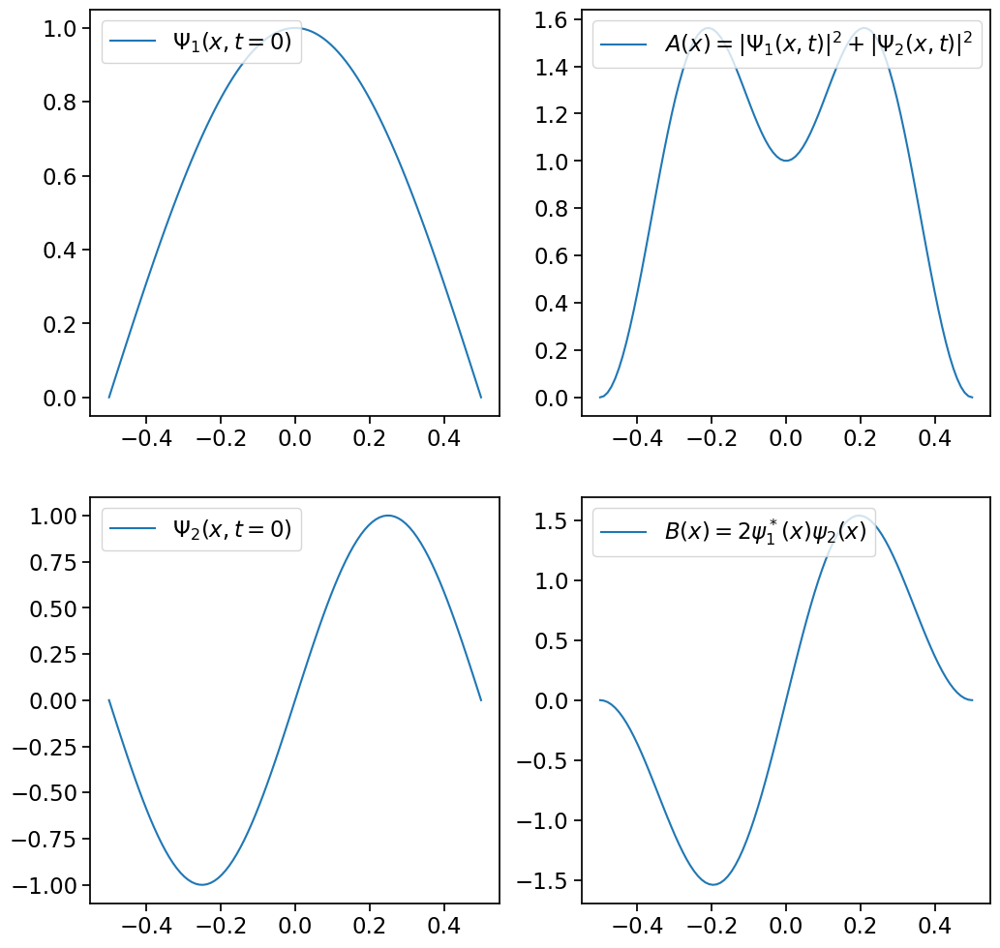

In [6]:
# Plot the spatial components of the wavefunction
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
axes[0,0].plot(x, psi_1, label=r'$\Psi_1(x,t=0)$')
axes[1,0].plot(x, psi_2, label=r'$\Psi_2(x,t=0)$')
axes[0,1].plot(x, A, label=r'$A(x)=|\Psi_1(x,t)|^2+|\Psi_2(x,t)|^2$')
axes[1,1].plot(x, B, label=r'$B(x)=2\psi_1^*{(x)}\psi_2{(x)}$')

for ax in axes.flatten():
    ax.legend(loc='upper left')
plt.show()

# Animation

In [7]:
# Array of time values for the animation
t_arr = np.linspace(0, 2/(3*np.pi), 250)

In [8]:
# Animate the Probability Density
fig, ax = plt.subplots(figsize=(12, 8))
line, = ax.plot([], [], lw=2)
ax.set_xlim(x[0], x[-1])
ax.set_ylim(0, np.max(A+B)*1.1)
ax.set_xlabel('x')
ax.set_ylabel(r'$\frac{dP}{dx}=\Phi^*(x,t)\Phi(x,t)=A(x)+B(x)\cos{((\omega_f-\omega_i)t)}$')
title = ax.set_title("Time: 0.00")

def init():
    line.set_data([], [])
    return line, title

def update(frame):
    y = dP_dx(t_arr[frame])
    line.set_data(x, y)
    title.set_text(f"Time: {t_arr[frame]:.2f}")
    return line, title

anim = FuncAnimation(
    fig, update, frames=t_arr.shape[0],
    init_func=init, blit=True, interval=50
)

# Display the animation inline
video = anim.to_jshtml()
plt.close()
display(HTML(video))